In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!pip install -qU pillow tiktoken

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 20.9 MB/s eta 0:00:00


# Data Loading

In [4]:
import os
import json

FLUX_IMG_DIR = os.path.join("/content/drive/MyDrive", 'FLUX DATASET')
TEST_DATASET_THREE_PING = os.path.join(FLUX_IMG_DIR, 'TEST_DATASET_THREE_PING')

if not os.path.exists(TEST_DATASET_THREE_PING):
  os.makedirs(TEST_DATASET_THREE_PING)

# Supporting Methods

In [5]:
import tiktoken

def count_tokens(text):
  encoding = tiktoken.get_encoding("cl100k_base")
  num_tokens = len(encoding.encode(text))
  return num_tokens

# Data Preprocessing
- Get list of images and txt
- Iterate
  - if a image has correlated txt file: Good!
    - "TEST_IMG_01.jpg" : "TETS_IMAGE_01.txt"
  - if a image doesn't have correlated txt file: Not Good!
    - Show the image
    - Get input
      - input should be at least have length of 20 words
      - if it's short get it again
    - Save correlated txt file.

In [6]:
# list of images
image_list = [image for image in os.listdir(TEST_DATASET_THREE_PING) if image.endswith(".jpg")]
# list of correlated text files
text_list = [text.split(".")[0] for text in os.listdir(TEST_DATASET_THREE_PING) if text.endswith(".txt")]

print(f"Number of images: {len(image_list)}")
print(f"Number of text files: {len(text_list)}")

image_needs_update = []
for image in image_list:
  if (image.split(".")[0] not in text_list):
    image_needs_update.append(image)

print(f"Number of images needs update: {len(image_needs_update)}")

Number of images: 10
Number of text files: 1
Number of images needs update: 9


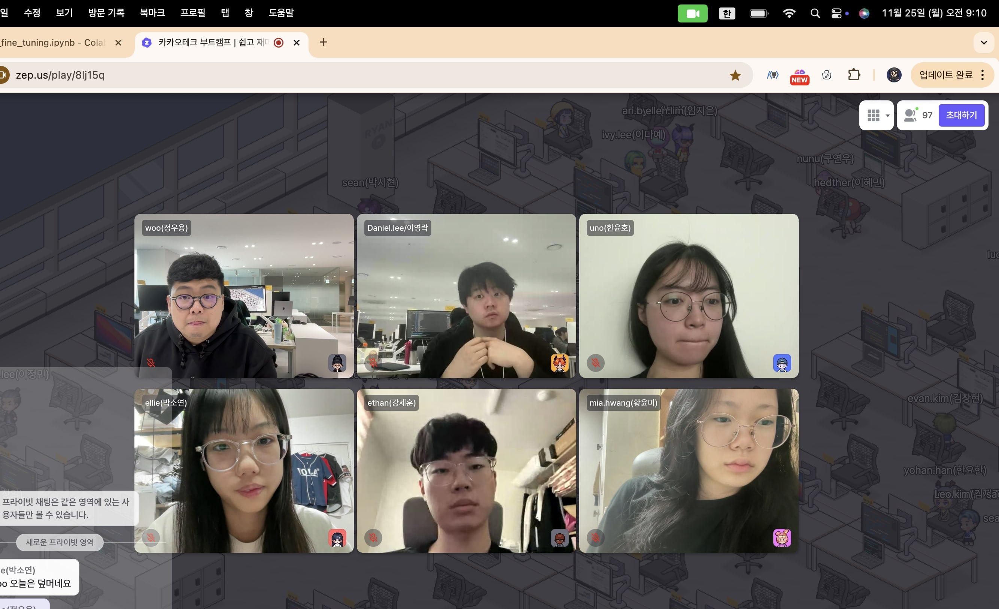

Enter description of the image: 6 people staring at the monitor to find a break through of the issue they found last night. It seems like they are bit tired due to multiple issues.
Number of tokens: 35


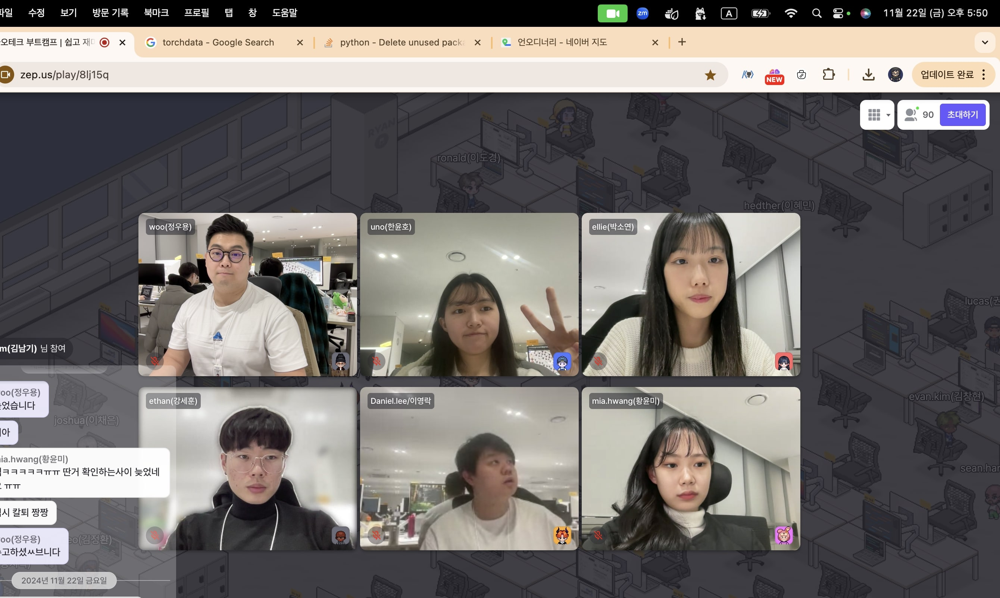

Enter description of the image: There are 6 people looking at the monitor to take picture to leave the office. They are all done with their daily task and that is why some of them are satisfied and happy.
Number of tokens: 40


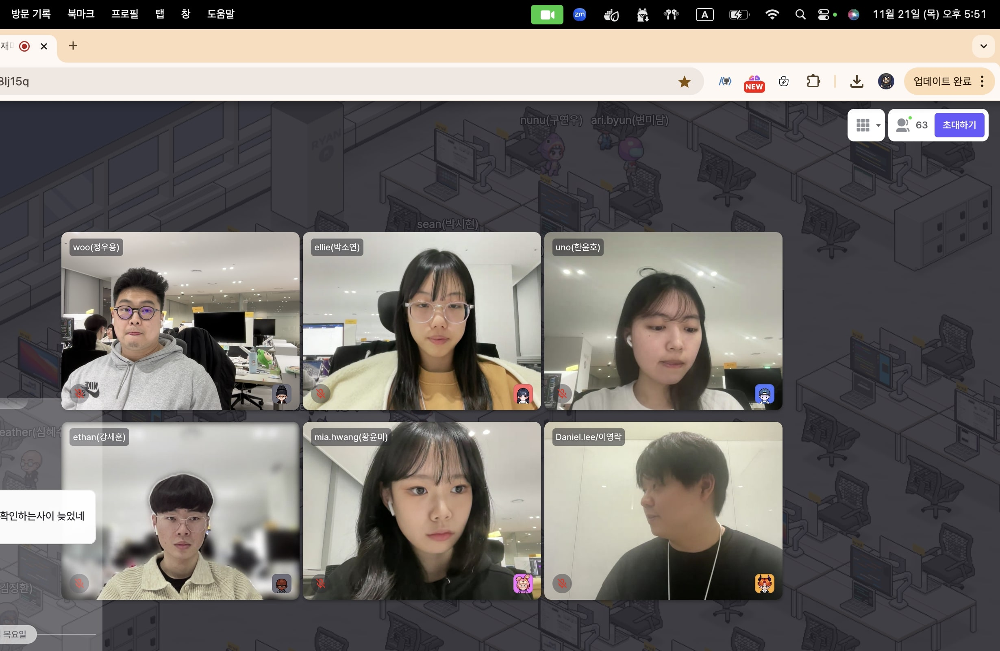

Enter description of the image: 6people looking at the screen and some of them are tired and some of them are not because there are some people who didn't finish their work and got to do extra hours to finish it.
Number of tokens: 43


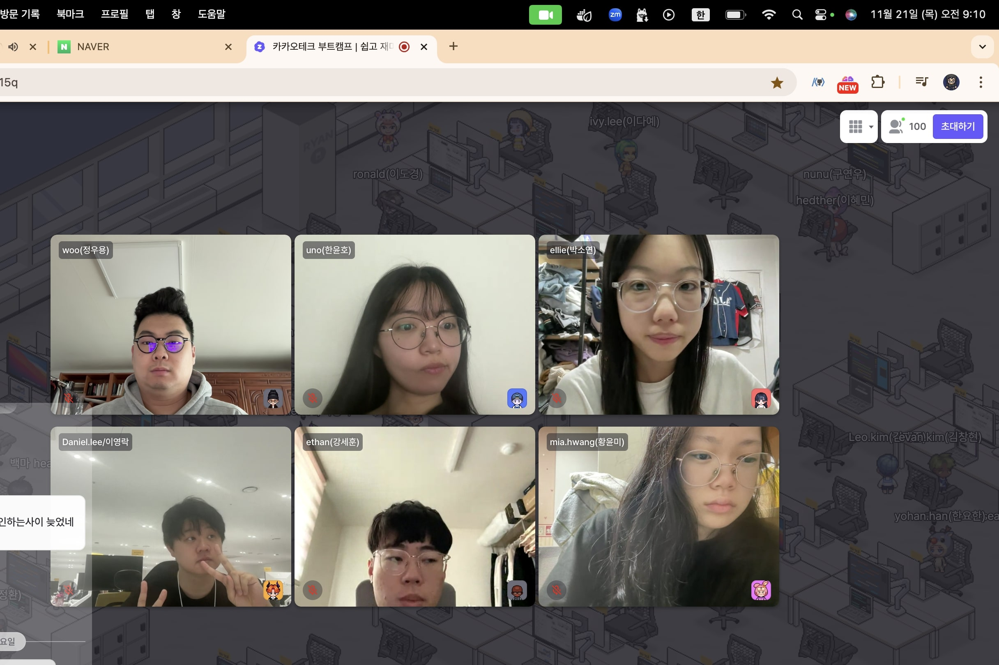

Enter description of the image: 6 people looking at the screen before they start their day. Actually some them are really tired because they just woke up.
Number of tokens: 28
Enter description of the image: 6 people looking at the screen before they start their day. Actually some them are really tired because they just woke up to take the picture
Number of tokens: 55


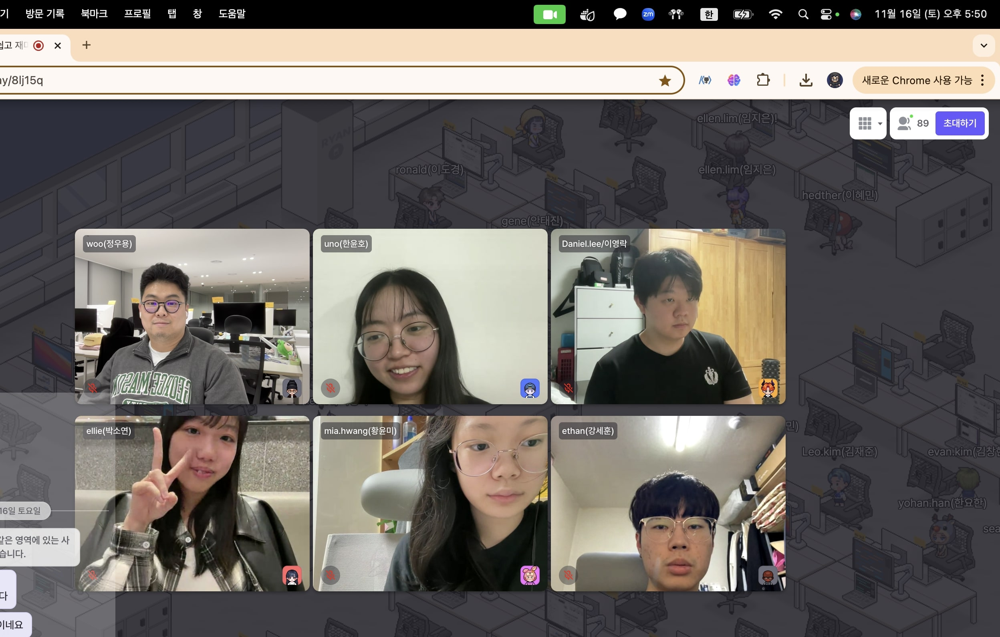

Enter description of the image: 6people are looking at the screen and kinda laughing because they are exited about weekend. Also, one of the team said something funny.
Number of tokens: 31


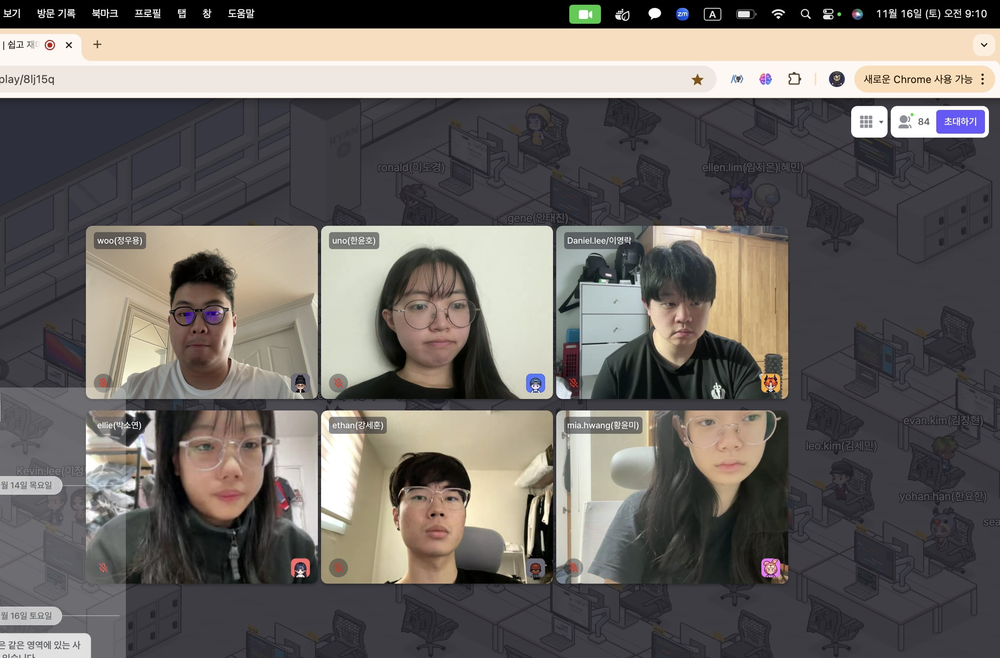

Enter description of the image: 6 people looking at the screen and taking a picture to start their daily task and talking about what they did last night.
Number of tokens: 28
Enter description of the image: Kinda tired because it's monday
Number of tokens: 34


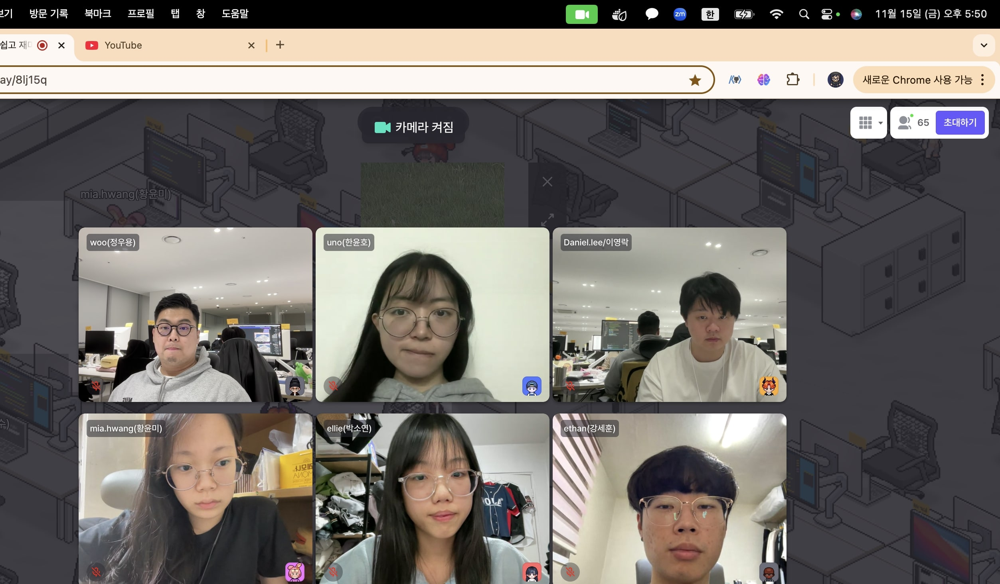

Enter description of the image: 6people looking at the screen and ready to leave. That's why some of them kinda excited because they can take a rest for the rest of the day.
Number of tokens: 36


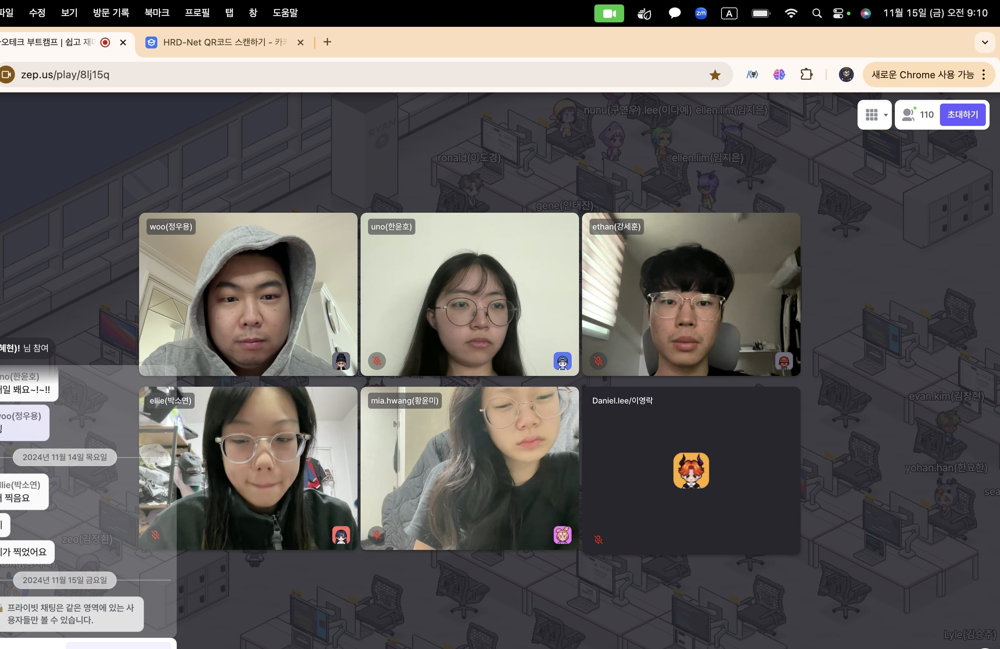

Enter description of the image: 5 people looking at the screen but one of them didn't show up and that's why they are so curious about it. While some of them just don't care because they are just tired
Number of tokens: 42


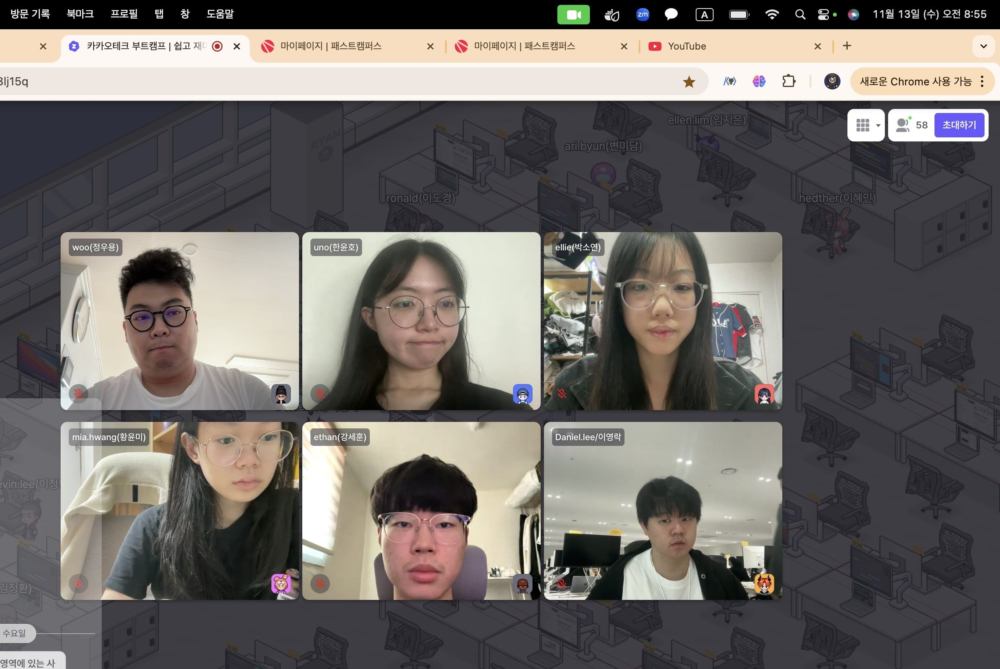

Enter description of the image: 6people looking at the screen to start the day. A lot of them looks tired but still trying to smile to take a picture and excited about their work.
Number of tokens: 36


In [7]:
from PIL import Image
from time import sleep

for image_file in image_needs_update:
  # image setting
  image = Image.open(os.path.join(TEST_DATASET_THREE_PING, image_file))
  text_input = "[trigger] "
  display(image)
  sleep(3)

  # getting a description about the image
  while (count_tokens(text_input) <= 30):
    text_input += input("Enter description of the image: ")
    print(f"Number of tokens: {count_tokens(text_input)}")

  # saving the description about the image
  text_file = image_file.split(".")[0] + ".txt"
  text_file_path = os.path.join(TEST_DATASET_THREE_PING, text_file)
  with open(text_file_path, "w") as file:
    file.write(text_input)